In [1]:
%matplotlib inline
import h5py
import matplotlib.pyplot as plt
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
import time
import numpy as np

from skimage import measure
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import proj3d


In [2]:
def load_data(data_name="train", num_files=5):
    data = []
    normals = []
    labels = []
    for idx in range(num_files):
        filename = "modelnet40_ply_hdf5_2048/ply_data_{}{}.h5".format(data_name, idx)
        with h5py.File(filename, 'r') as f:
            data.append(np.array(f['data']))
            labels.append(np.reshape(np.array(f['label']), -1))
    return np.concatenate(data, axis=0), np.concatenate(labels, axis=0)

In [3]:
train_data, train_labels = load_data("train", 5)
test_data, test_labels = load_data("test", 2)

In [4]:
train_data.shape

(9840, 2048, 3)

In [5]:
train_labels.shape

(9840,)

In [6]:
train_labels[:10]

array([30, 27, 30, 29, 22,  7, 28,  0, 30, 20], dtype=uint8)

In [7]:
shapename_filename = "modelnet40_ply_hdf5_2048/shape_names.txt"
shape_names = pd.read_csv(shapename_filename, header=None)
shape_names = [x[1][0] for x in shape_names.iterrows()]

In [8]:

def plot_point_cloud(data, elev_incre=30, azim_incre=30):
    xs = data[:,0]
    ys = data[:,1]
    zs = data[:,2]

    n_elev = int(np.ceil(181/elev_incre))
    n_azim = int(np.ceil(360/azim_incre))

    fig = plt.figure(figsize=(3.33*n_azim, 3.33*n_elev))

    for i, elev in enumerate(range(-90, 91, elev_incre)):
        for j, azim in enumerate(range(0, 360, azim_incre)):
            ax = fig.add_subplot(n_elev, n_azim, i*n_azim+j+1, projection='3d')
            ax.scatter(xs, ys, zs, s=0.1)
            # ax.scatter(xs, ys, zs, c=c, marker=m)

            ax.set_xlabel('x')
            ax.set_ylabel('y')
            ax.set_zlabel('z')

            ax.set_title("e{},a{}".format(elev, azim))
            ax.set_aspect('equal', 'box')

            X = xs
            Y = ys
            Z = zs
            max_range = np.array([X.max()-X.min(), Y.max()-Y.min(), Z.max()-Z.min()]).max() / 2.0

            mid_x = (X.max()+X.min()) * 0.5
            mid_y = (Y.max()+Y.min()) * 0.5
            mid_z = (Z.max()+Z.min()) * 0.5
            ax.set_xlim(mid_x - max_range, mid_x + max_range)
            ax.set_ylim(mid_y - max_range, mid_y + max_range)
            ax.set_zlim(mid_z - max_range, mid_z + max_range)

            ax.view_init(elev, azim)

    plt.show()


## Examples of training data

curtain 5681


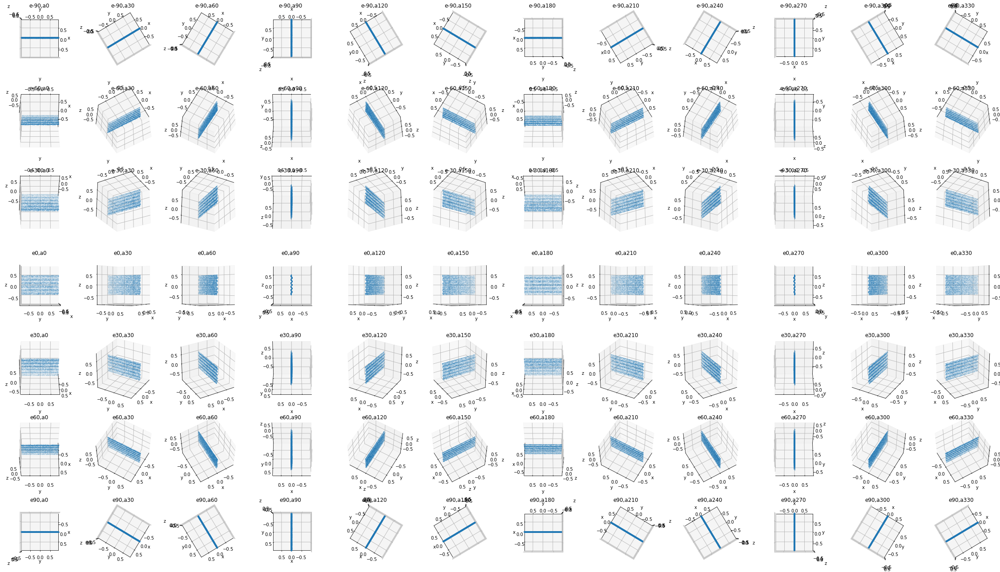

xbox 4503


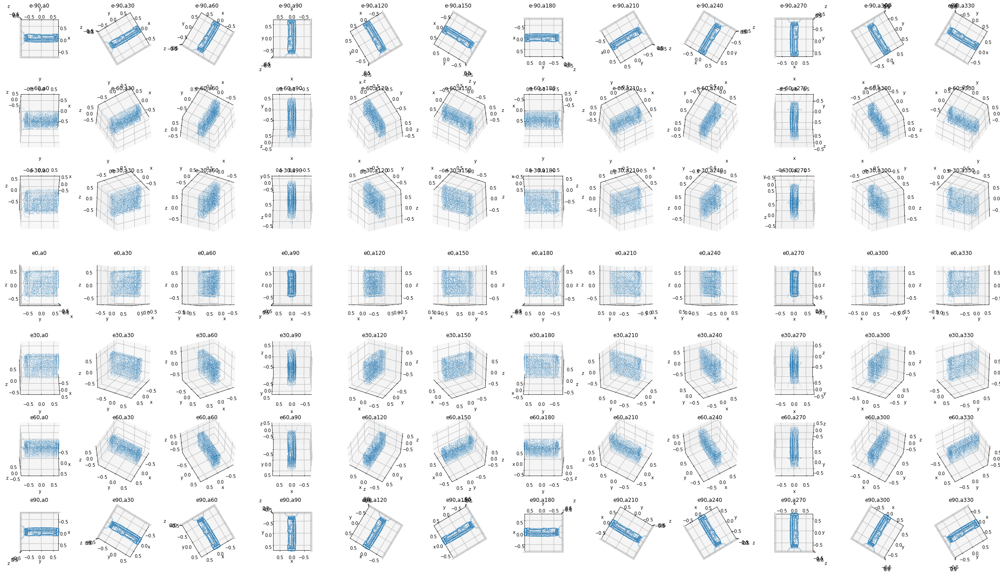

monitor 2297


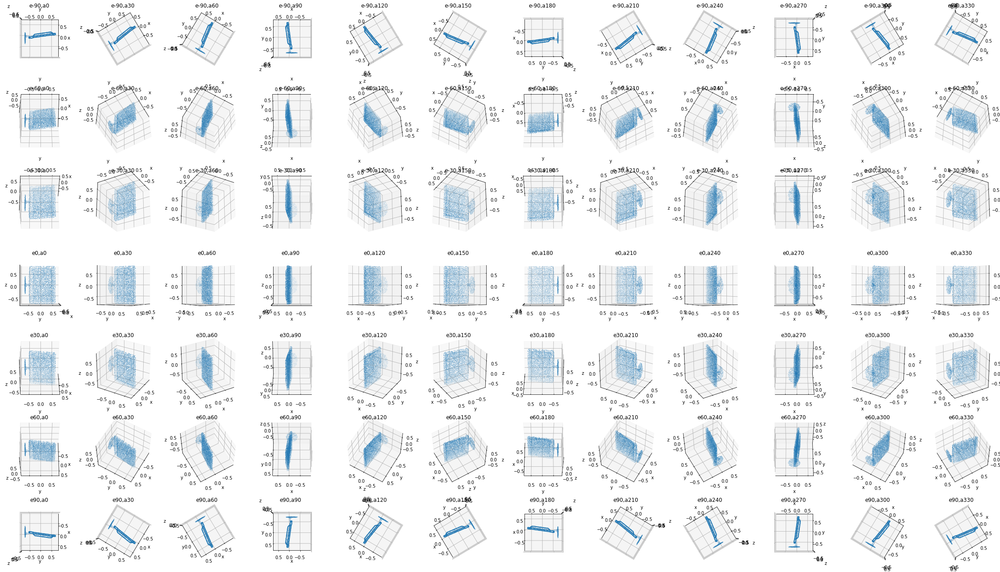

airplane 8041


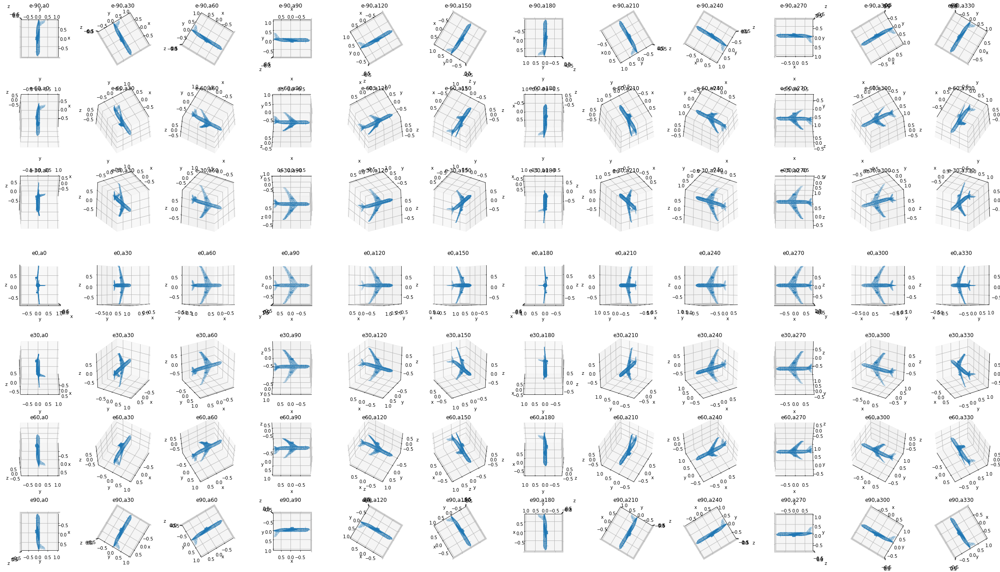

sofa 5503


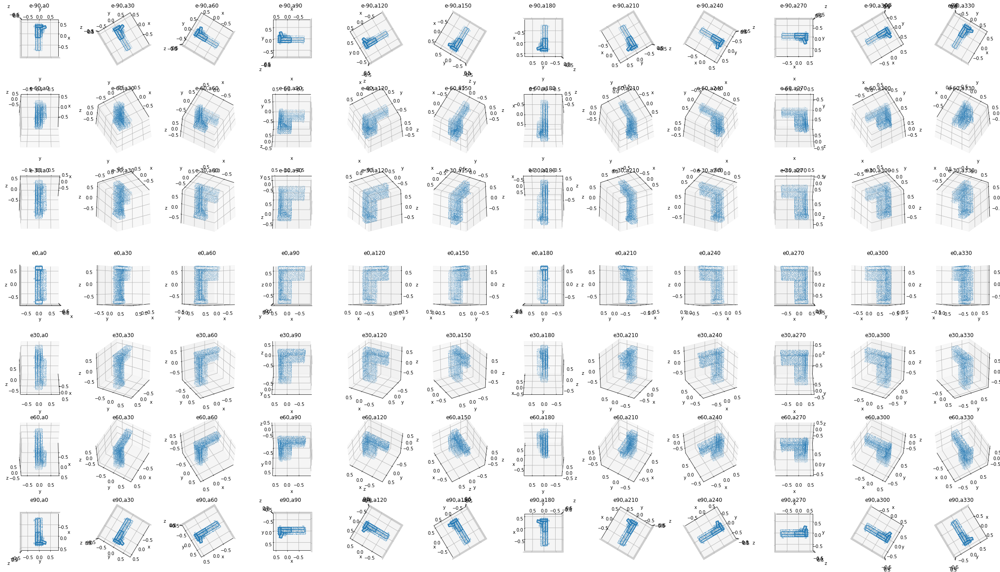

In [72]:
for idx in np.random.randint(0, train_data.shape[0], 5):
    print(shape_names[train_labels[idx]], idx)
    plot_point_cloud(train_data[idx])

## Examples of test data

xbox 1864


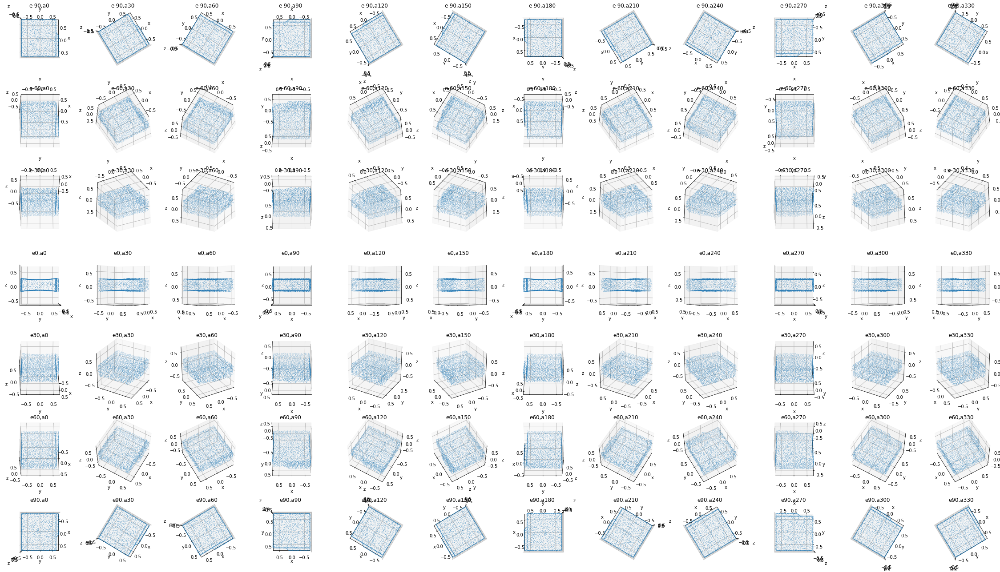

table 917


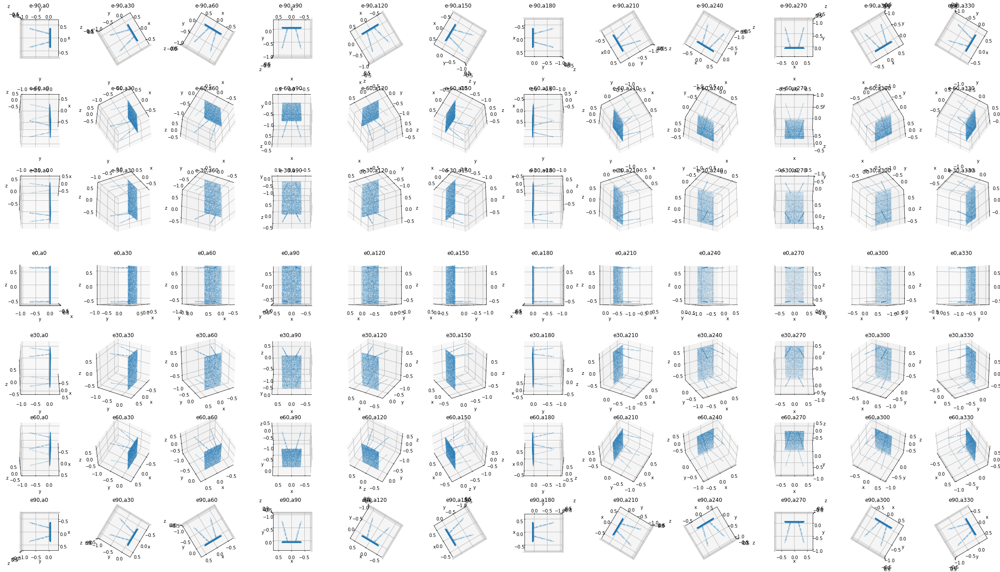

guitar 1870


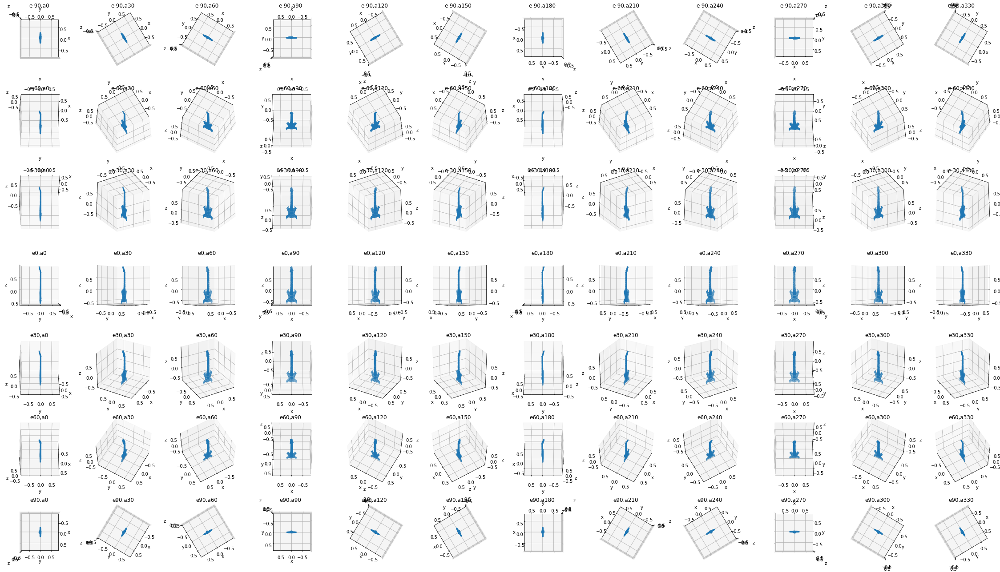

sink 781


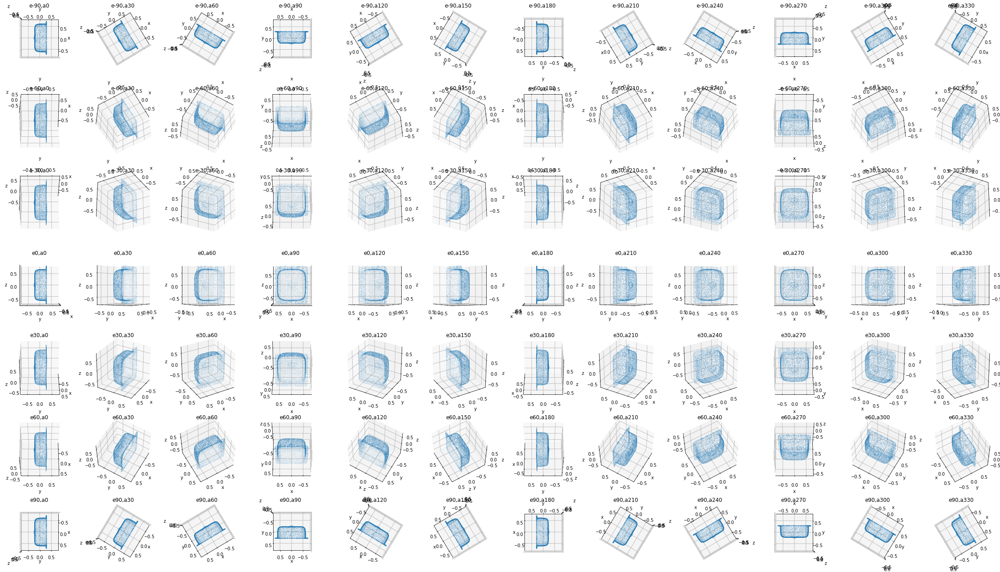

table 60


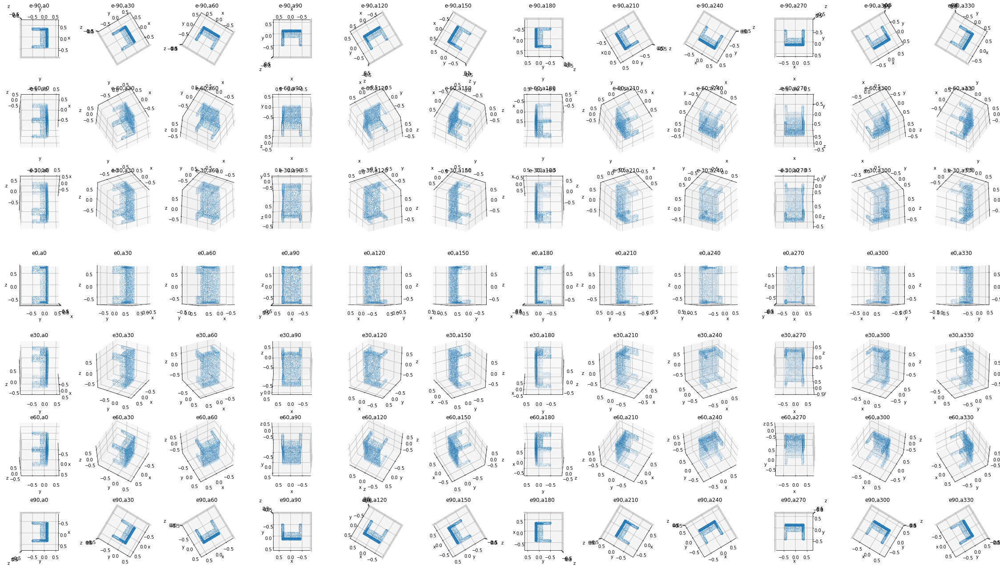

In [73]:
for idx in np.random.randint(0, test_data.shape[0], 5):
    print(shape_names[test_labels[idx]], idx)
    plot_point_cloud(test_data[idx])

In [74]:
print(shape_names)


['airplane', 'bathtub', 'bed', 'bench', 'bookshelf', 'bottle', 'bowl', 'car', 'chair', 'cone', 'cup', 'curtain', 'desk', 'door', 'dresser', 'flower_pot', 'glass_box', 'guitar', 'keyboard', 'lamp', 'laptop', 'mantel', 'monitor', 'night_stand', 'person', 'piano', 'plant', 'radio', 'range_hood', 'sink', 'sofa', 'stairs', 'stool', 'table', 'tent', 'toilet', 'tv_stand', 'vase', 'wardrobe', 'xbox']


## Label distribution

In [9]:
from collections import Counter

ValueError: shape mismatch: objects cannot be broadcast to a single shape

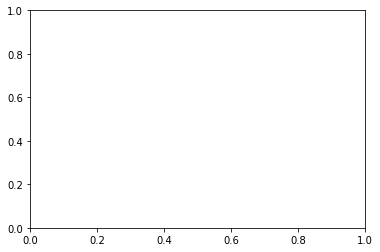

In [11]:
labels = train_labels

label_name_inds = [shape_names[x] for x in labels]
# count = Counter(label_name_inds)
count = Counter(labels)
count = [count[x] for x in sorted(count.keys())]

# plt.figure(figsize=(20,5))
# _ = plt.hist(label_name_inds)


y_pos = np.arange(len(labels))

plt.barh(y_pos, count, align='center')
# ax.set_yticks(y_pos)
# ax.set_yticklabels(shape_names)
plt.invert_yaxis()  # labels read top-to-bottom
# ax.set_xlabel('Performance')
# ax.set_title('How fast do you want to go today?')

# plt.show()


## Examples


#### Sofa

#### Keyboard


#### Stairs

## Default size and orientation

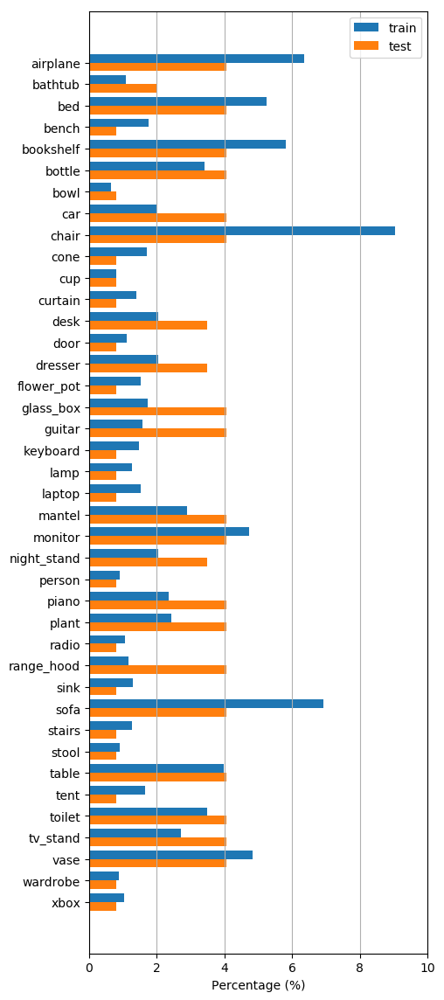

In [75]:
from collections import Counter

labels = train_labels

label_name_inds = [shape_names[x] for x in labels]
count = Counter(labels)
count = np.array([count[x] for x in sorted(count.keys())], dtype=float)
count /= count.sum() / 100

width = 0.8

y_pos = np.arange(len(count))*2

fig = plt.figure(figsize=(5, 14))

ax = fig.add_subplot(1,1,1)
ax.barh(y_pos, count, align='center')
# ax.set_yticks(y_pos)
# ax.set_yticklabels(shape_names)
# ax.invert_yaxis()  # labels read top-to-bottom
# ax.set_xlabel('Percentage (%)')
# ax.set_title('Training Label Distribution')


labels = test_labels

label_name_inds = [shape_names[x] for x in labels]
count = Counter(labels)
count = np.array([count[x] for x in sorted(count.keys())], dtype=float)
count /= count.sum() / 100

# ax = fig.add_subplot(1,2,2)
ax.barh(y_pos+width, count, align='center')
ax.set_yticks(y_pos+0.5*width)
ax.set_yticklabels(shape_names)
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Percentage (%)')
# ax.set_title('Training Label Distribution')
ax.xaxis.grid(True)
ax.set_xlim((0, 10))

ax.legend(["train", "test"])
plt.show()

fig.savefig("modelnet40_dist.pdf", bbox_inches='tight')

In [46]:
len(train_labels)

9840

In [47]:
len(test_labels)

2468

In [90]:

def plot_point_cloud2(data, elev_incre=45, azim_incre=45):
    xs = data[:,0]
    ys = data[:,1]
    zs = data[:,2]

    n_elev = int(np.ceil(181/elev_incre))
    n_azim = int(np.ceil(181/azim_incre))

    fig = plt.figure(figsize=(2*n_azim, 2*n_elev))

    for i, elev in enumerate(range(-180, 1, elev_incre)):
        for j, azim in enumerate(range(0, 181, azim_incre)):
            ax = fig.add_subplot(n_elev, n_azim, i*n_azim+j+1, projection='3d')
            ax.scatter(xs, ys, zs, s=0.1)
            # ax.scatter(xs, ys, zs, c=c, marker=m)

            ax.set_xlabel('x', fontsize=8)
            ax.set_ylabel('y', fontsize=8)
            ax.set_zlabel('z', fontsize=8)

            #ax.set_title("e={},a={}".format(elev, azim))
            ax.set_aspect('equal', 'box')

            X = xs
            Y = ys
            Z = zs
            max_range = np.array([X.max()-X.min(), Y.max()-Y.min(), Z.max()-Z.min()]).max() / 2.0

            mid_x = (X.max()+X.min()) * 0.5
            mid_y = (Y.max()+Y.min()) * 0.5
            mid_z = (Z.max()+Z.min()) * 0.5
            ax.set_xlim(mid_x - max_range, mid_x + max_range)
            ax.set_ylim(mid_y - max_range, mid_y + max_range)
            ax.set_zlim(mid_z - max_range, mid_z + max_range)

            ax.tick_params(axis='both', which='major', labelsize=6)
            ax.tick_params(axis='both', which='minor', labelsize=4)
            ax.view_init(elev, azim)

    plt.show()


In [116]:
inds = [i for i, x in enumerate(test_labels[:500]) if shape_names[x]=="dresser"]

47


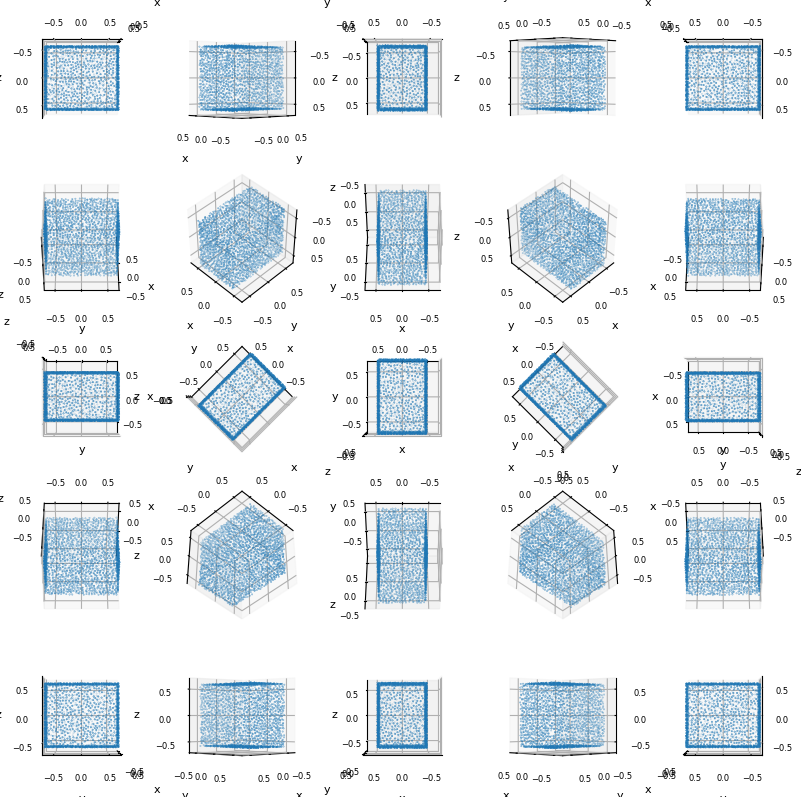

48


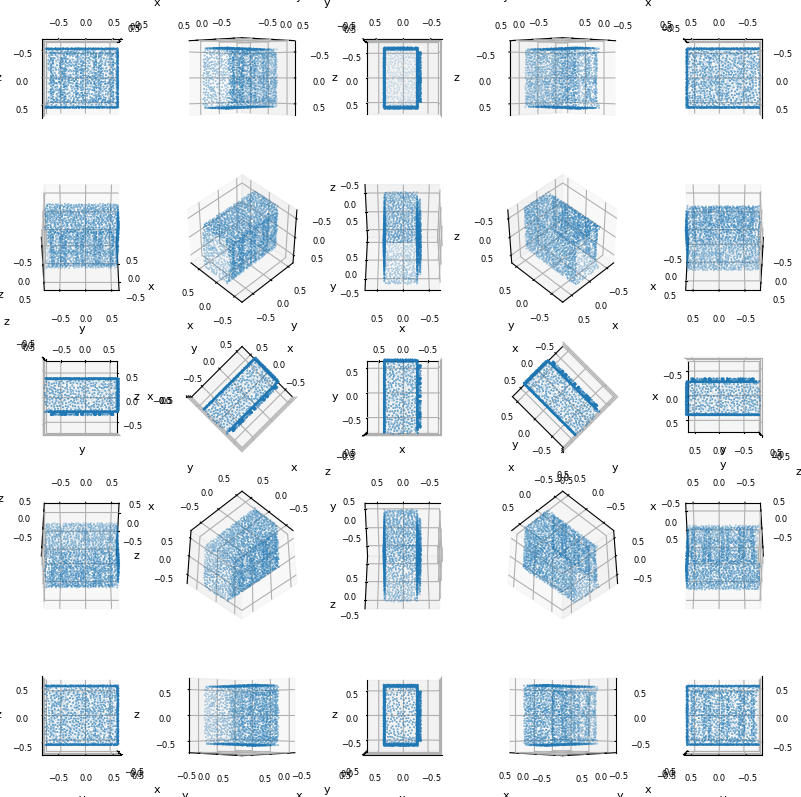

55


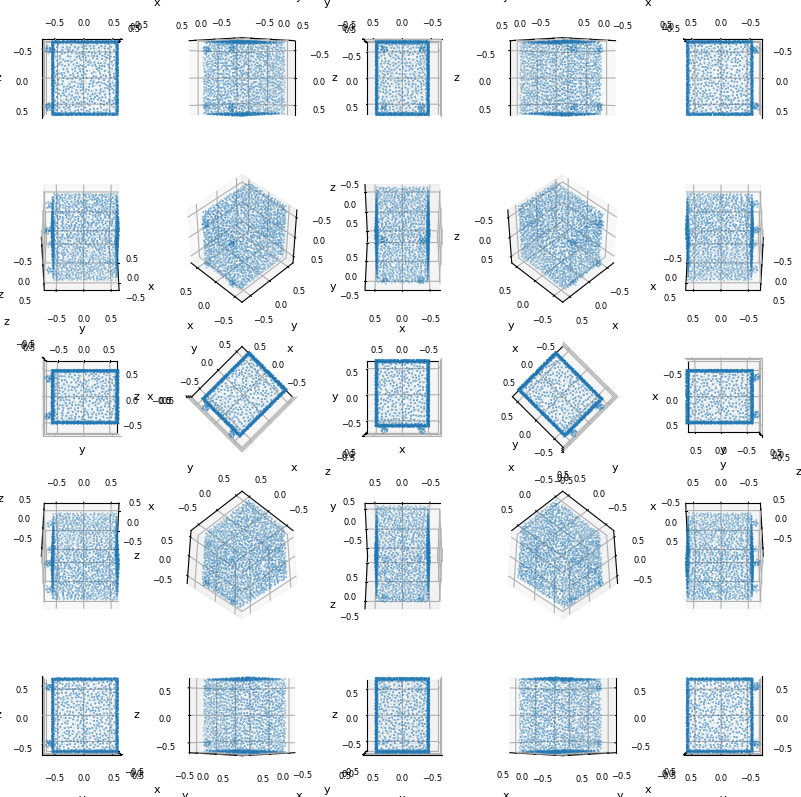

148


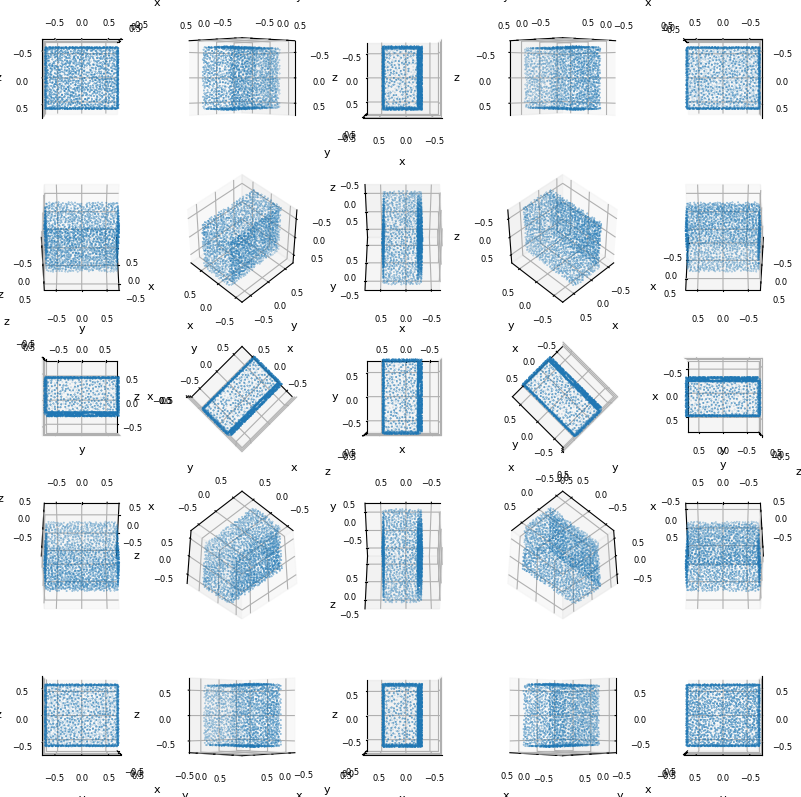

156


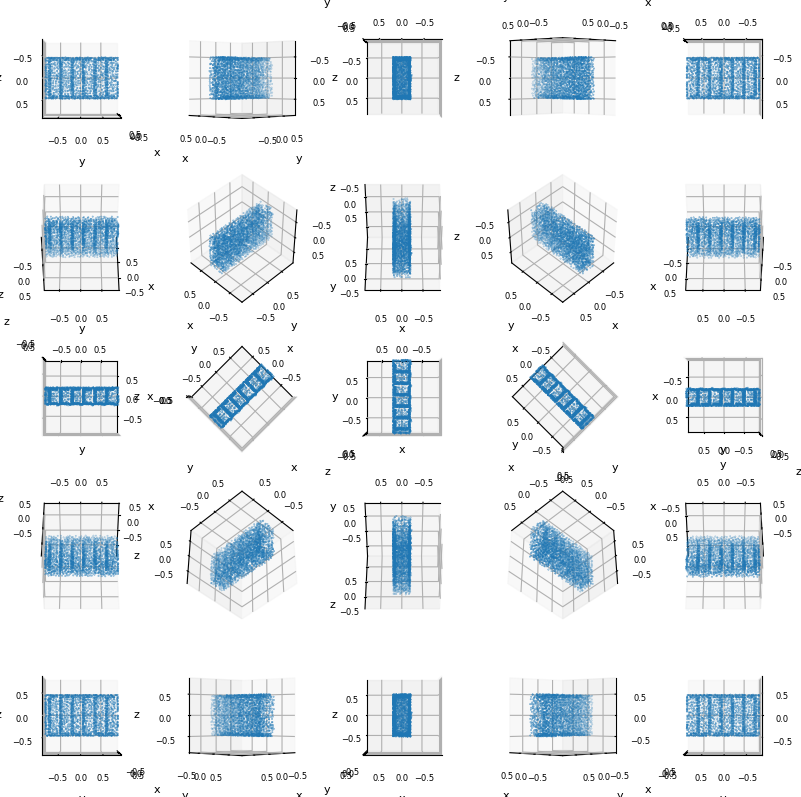

171


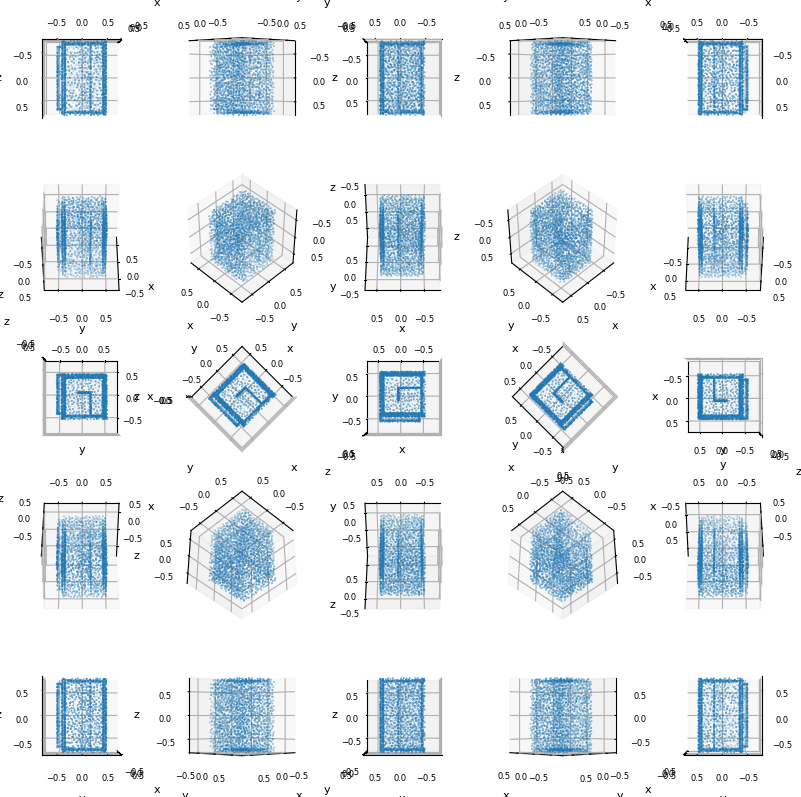

210


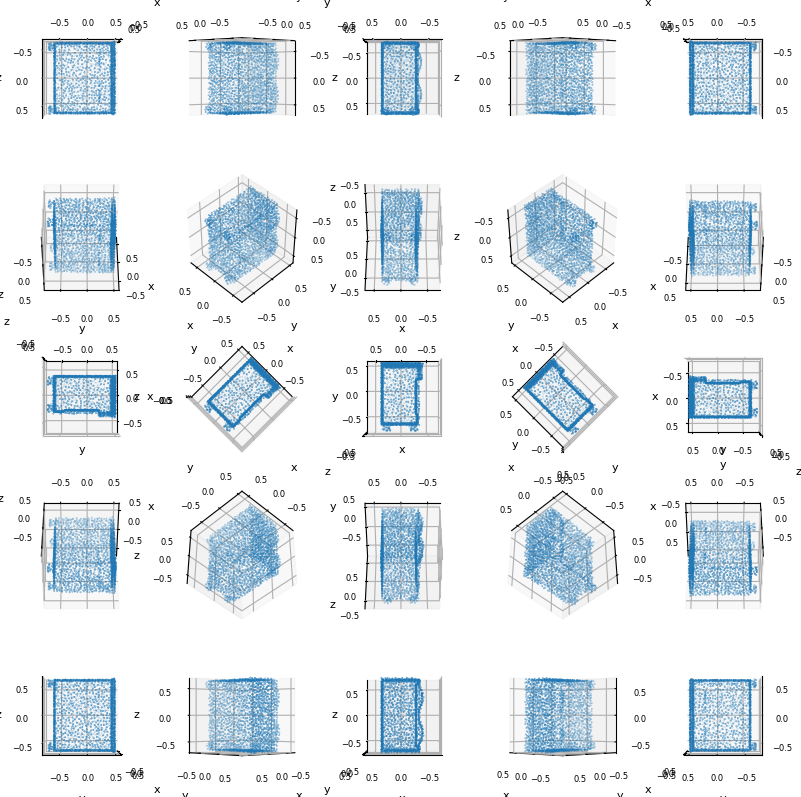

216


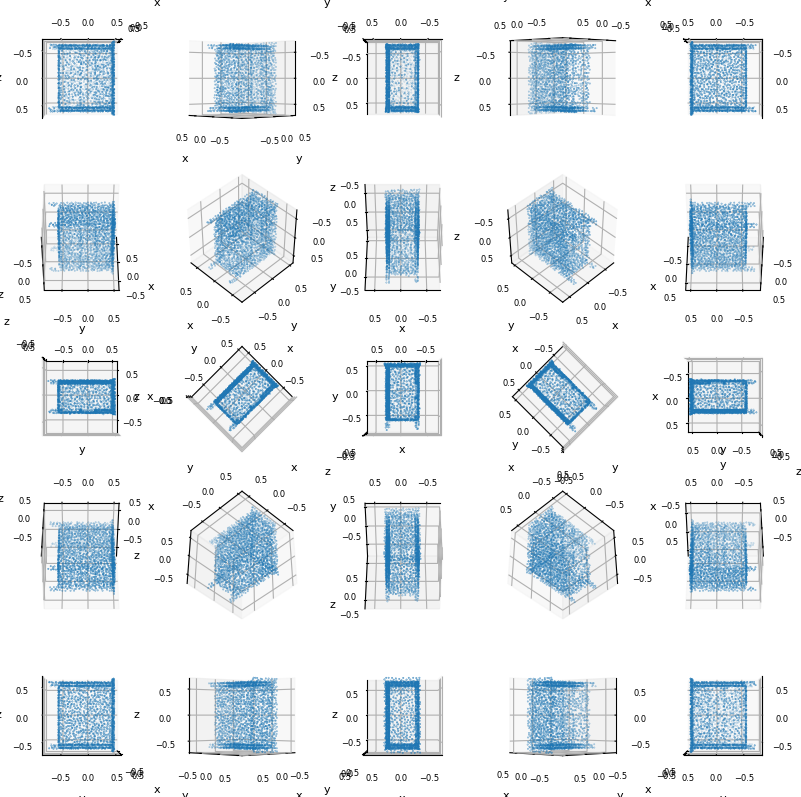

221


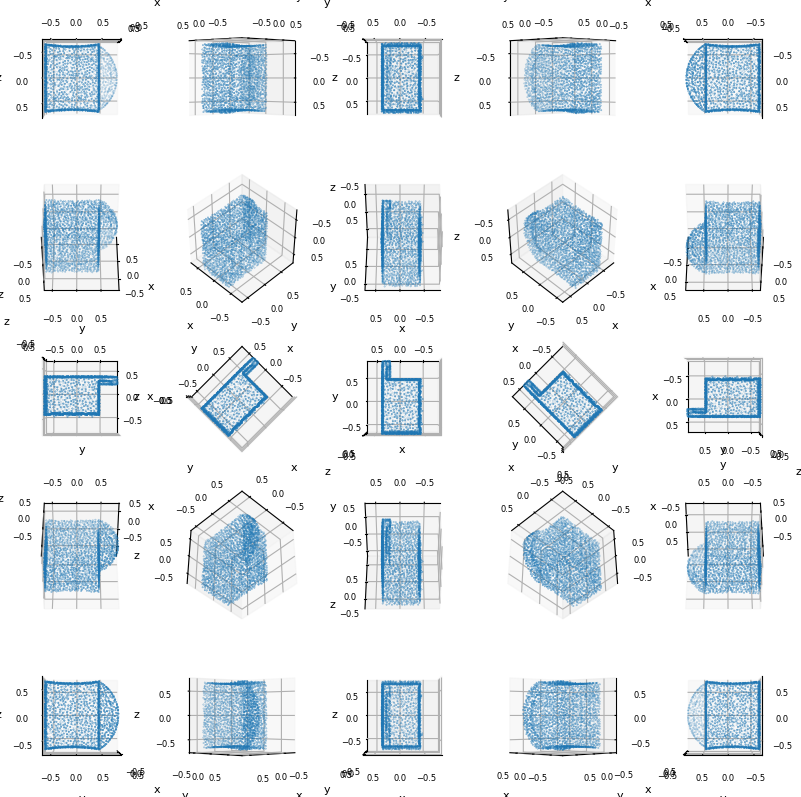

235


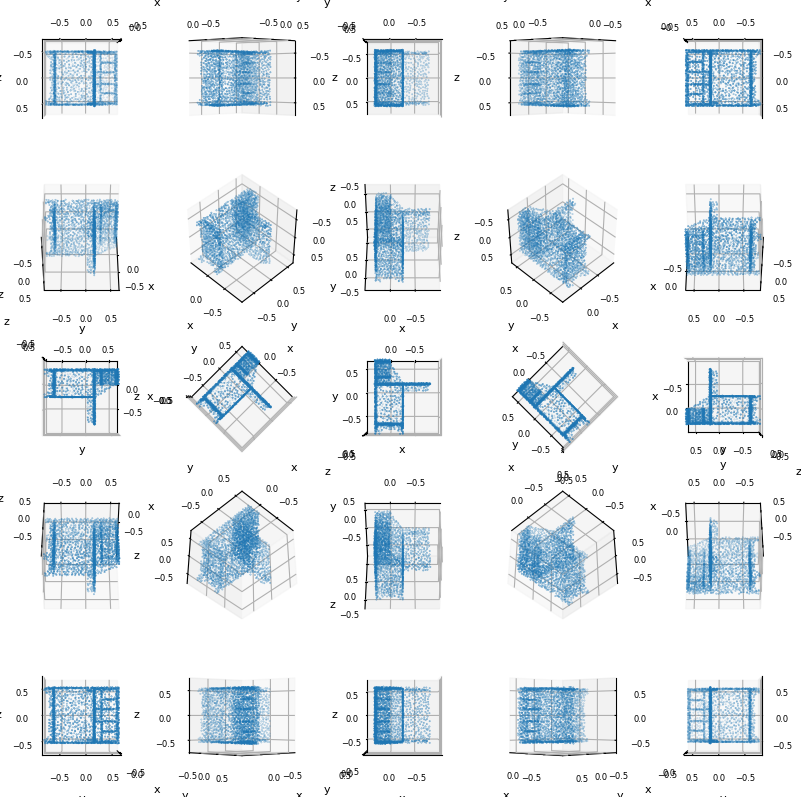

250


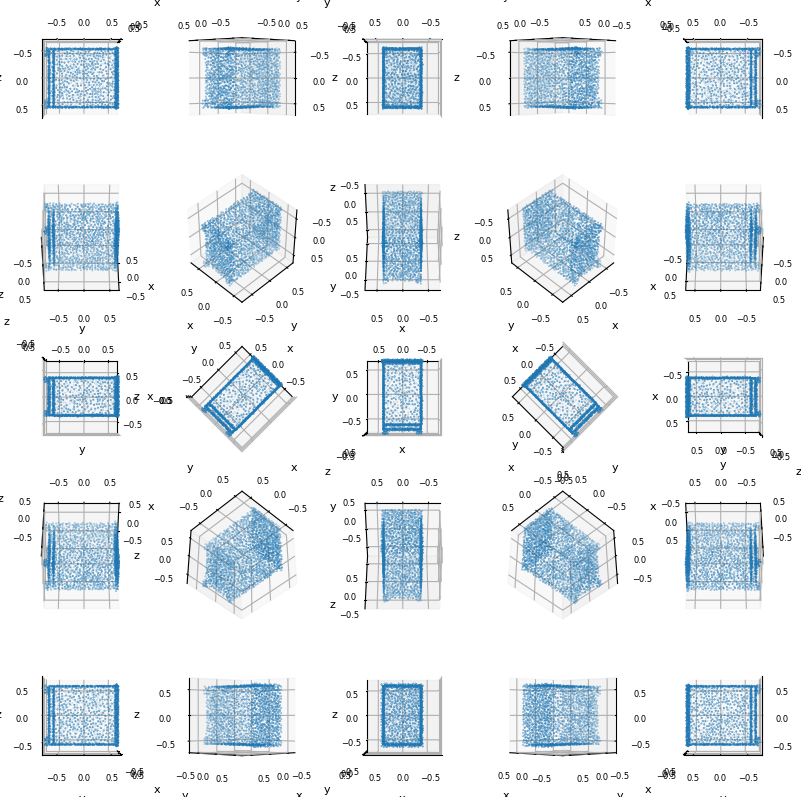

272


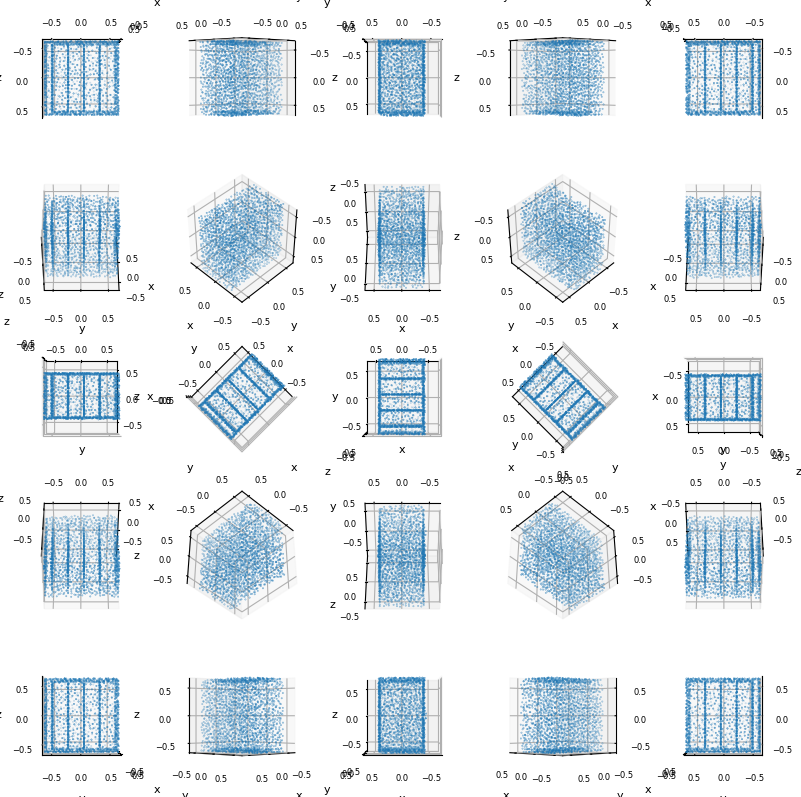

273


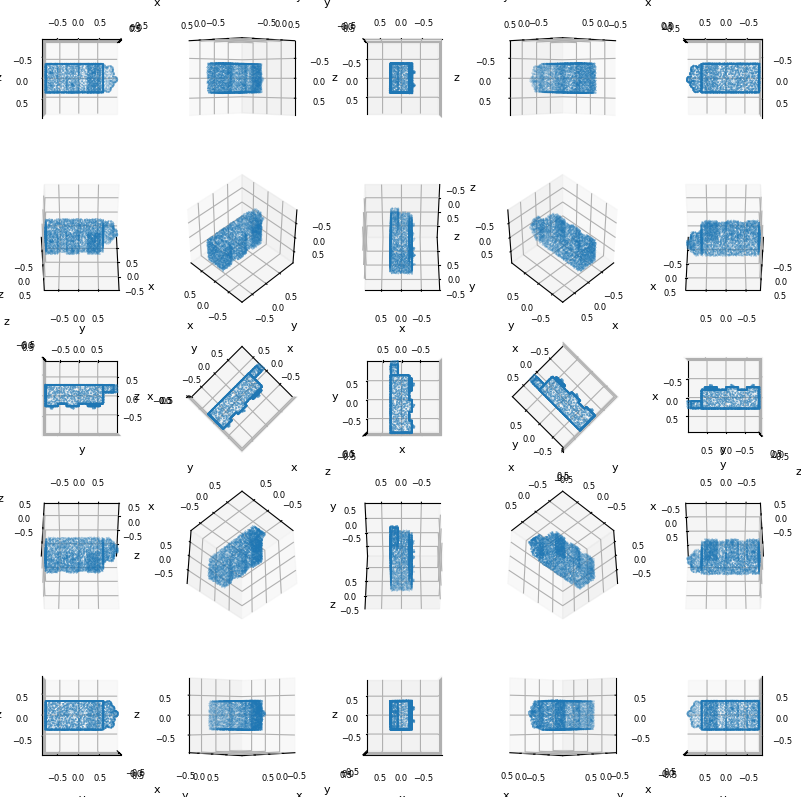

308


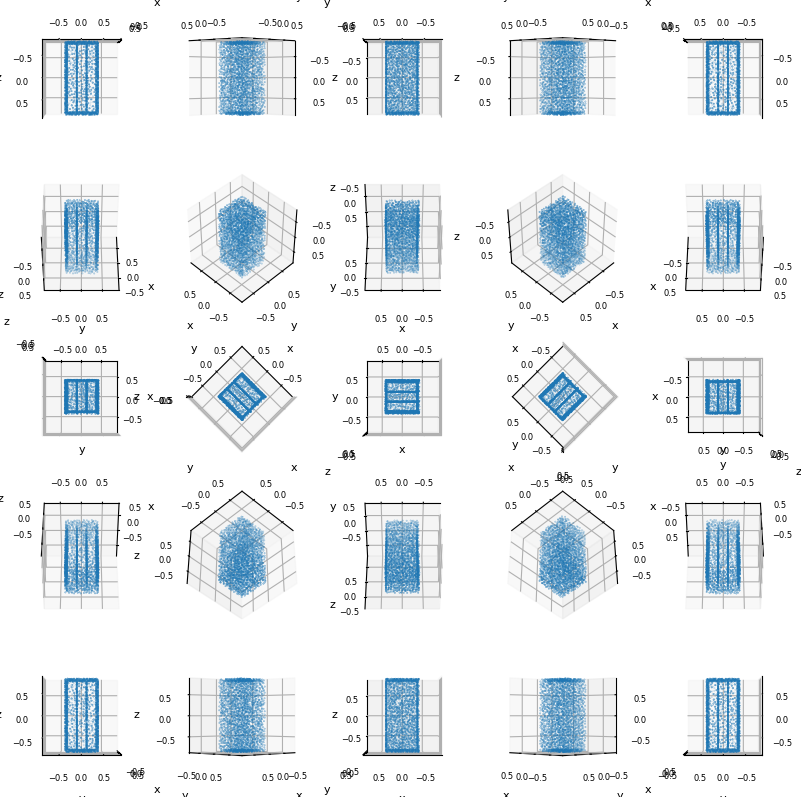

310


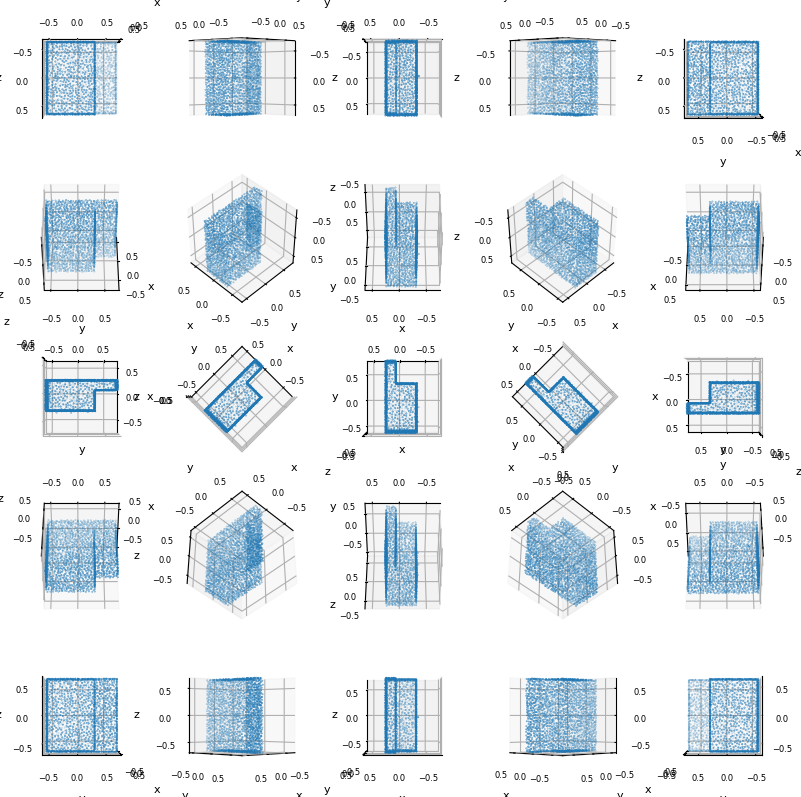

334


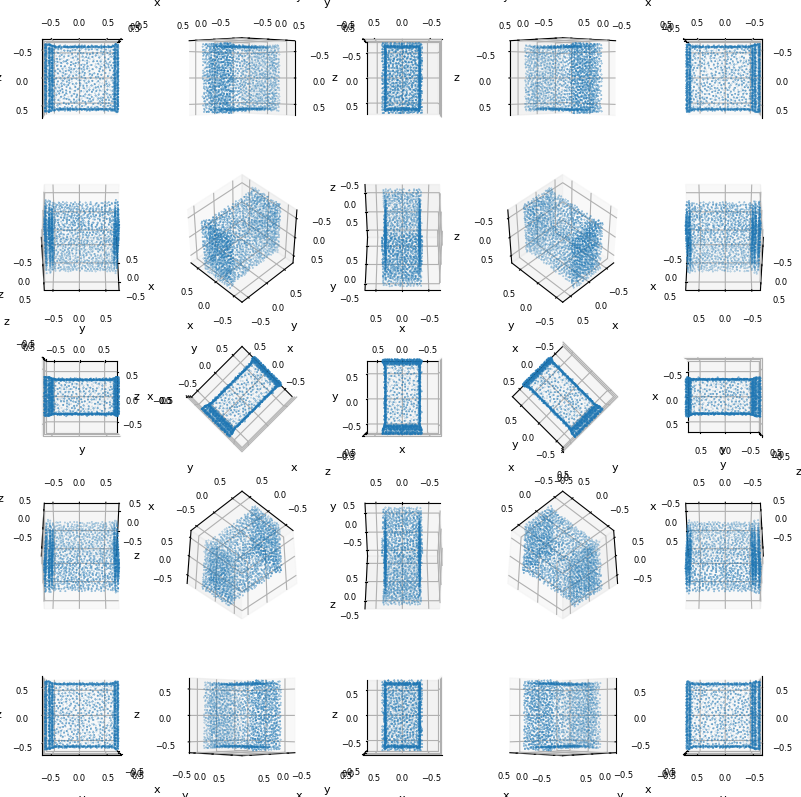

338


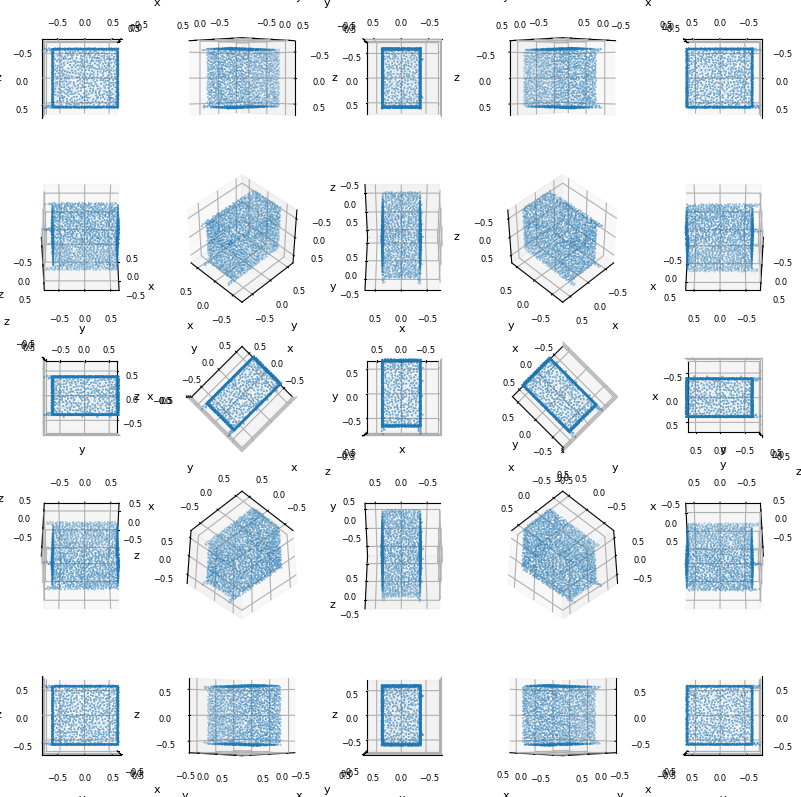

406


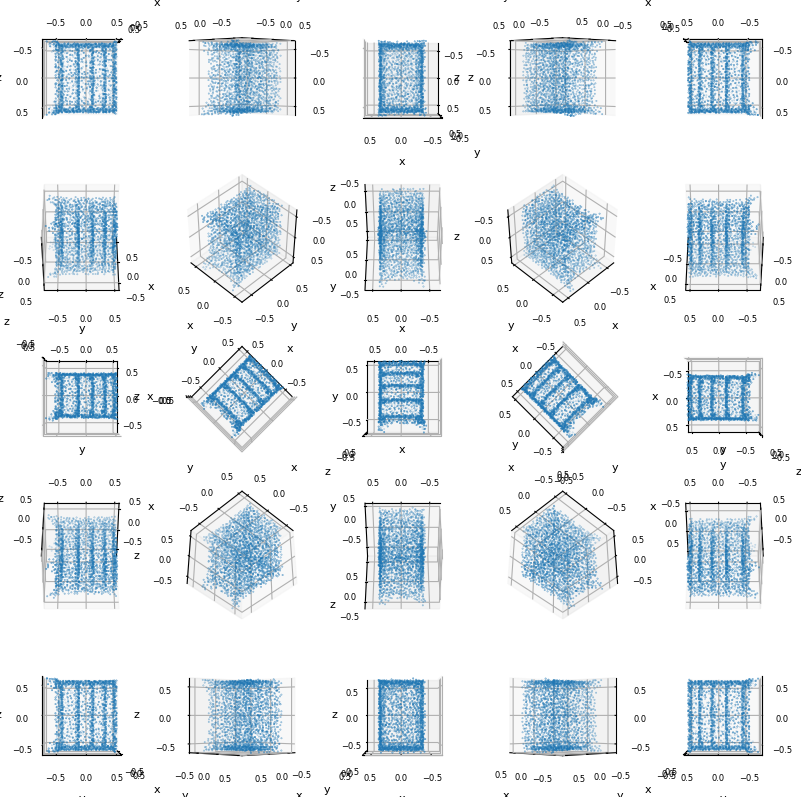

448


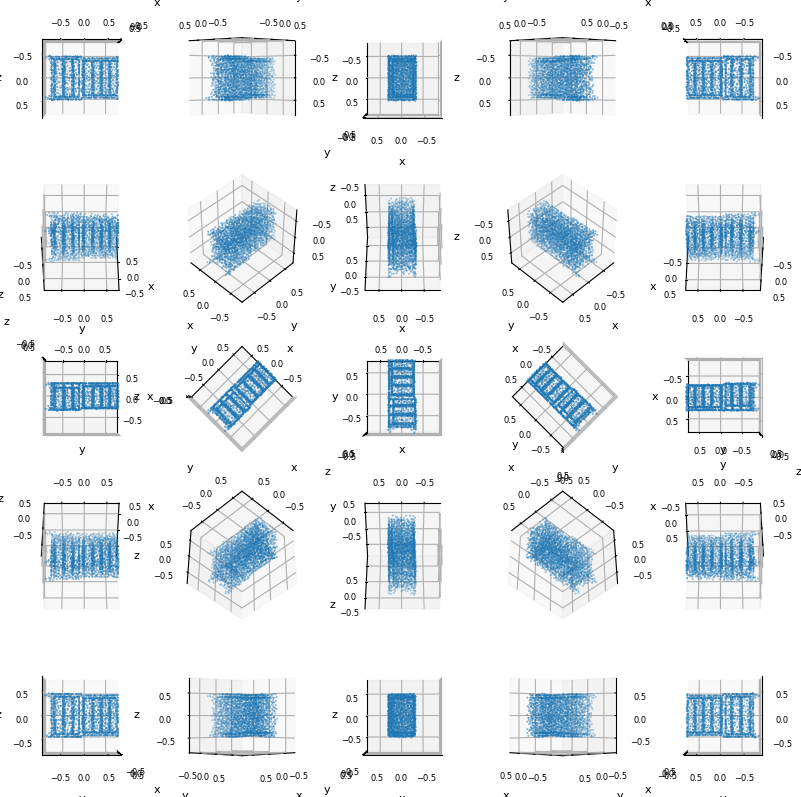

459


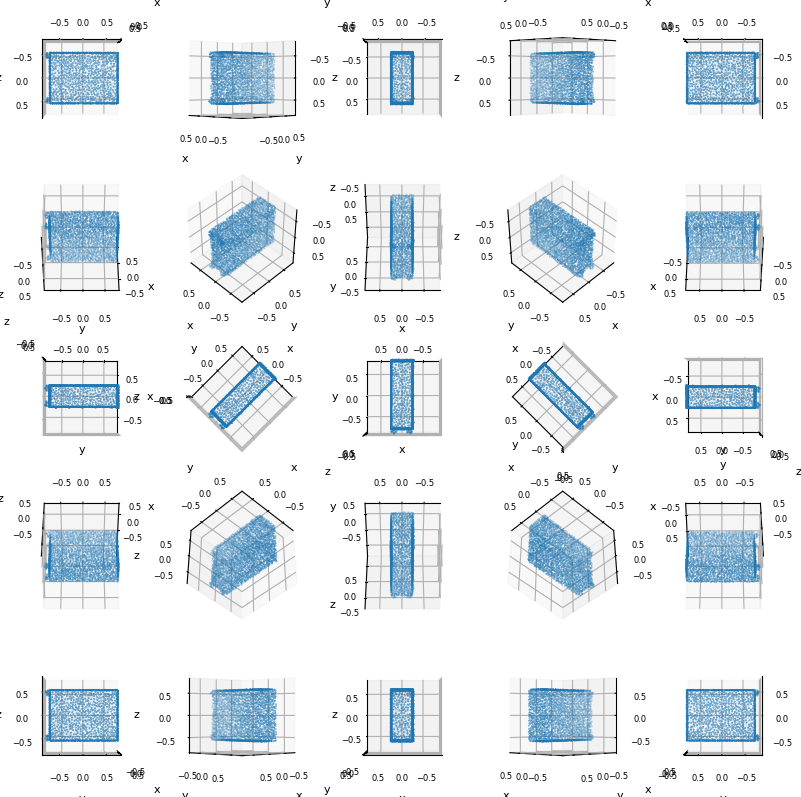

In [117]:
for i in inds:
    print(i)
    plot_point_cloud2(test_data[i])


In [145]:
def plot_point_cloud3(data):
    xs = data[:,0]
    ys = data[:,1]
    zs = data[:,2]

    elev_incre, azim_incre = 45, 45
    n_elev = int(np.ceil(181/elev_incre))
    n_azim = int(np.ceil(181/azim_incre))

    fig = plt.figure(figsize=(4, 4))
    titles = ["top", "side", "front", "45 degs"]

    for i, (elev, azim) in enumerate([(-180, 90), (-180, 180), (-90, 90), (-135, 135)]):
        ax = fig.add_subplot(2,2,i+1, projection='3d')
        ax.scatter(xs, ys, zs, s=0.1)
        # ax.scatter(xs, ys, zs, c=c, marker=m)

#         ax.set_xlabel('x', fontsize=8)
#         ax.set_ylabel('y', fontsize=8)
#         ax.set_zlabel('z', fontsize=8)

        #ax.set_title("e={},a={}".format(elev, azim))
        ax.set_aspect('equal', 'box')

        X = xs
        Y = ys
        Z = zs
        max_range = np.array([X.max()-X.min(), Y.max()-Y.min(), Z.max()-Z.min()]).max() / 2.0

        mid_x = (X.max()+X.min()) * 0.5
        mid_y = (Y.max()+Y.min()) * 0.5
        mid_z = (Z.max()+Z.min()) * 0.5
        ax.set_xlim(mid_x - max_range, mid_x + max_range)
        ax.set_ylim(mid_y - max_range, mid_y + max_range)
        ax.set_zlim(mid_z - max_range, mid_z + max_range)
        ax.set_title(titles[i], fontsize=9)

        ax.tick_params(axis='both', which='major', labelsize=6)
        ax.tick_params(axis='both', which='minor', labelsize=4)
        ax.view_init(elev, azim)

    plt.show()
    return fig


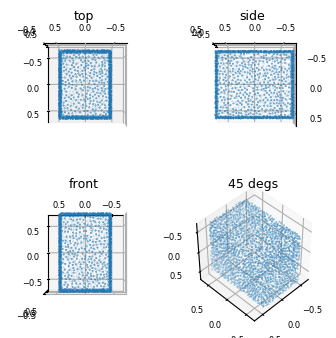

In [146]:
fig = plot_point_cloud3(test_data[47])

In [147]:
fig.savefig("difficult_object_for_human.pdf", bbox_inches='tight')